AIDI-2004 Lab - 2
Name - Naman Pathak
Student Id - 100899717

In [2]:
# importing necessary libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load the data
data = pd.read_csv('C:/Users/naman/Downloads/Exercise-1(St Id - 100899717)/dataset.csv')

# Check the data shape
print("No. of rows and columns: ", data.shape)

# Check for missing values
print("\n",data.isnull().sum())

# Summary statistics
data.describe()

No. of rows and columns:  (569, 32)

 id                   0
diagnosis            0
radius_mean          0
texture_mean         0
perimeter_mean       0
area_mean            0
smoothness_mean      0
compactness_mean     0
concavity_mean       0
points_mean          0
symmetry_mean        0
dimension_mean       0
radius_se            0
texture_se           0
perimeter_se         0
area_se              0
smoothness_se        0
compactness_se       0
concavity_se         0
points_se            0
symmetry_se          0
dimension_se         0
radius_worst         0
texture_worst        0
perimeter_worst      0
area_worst           0
smoothness_worst     0
compactness_worst    0
concavity_worst      0
points_worst         0
symmetry_worst       0
dimension_worst      0
dtype: int64


,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,points_worst,symmetry_worst,dimension_worst
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


Exploratory Data Analysis of above breast cancer dataset

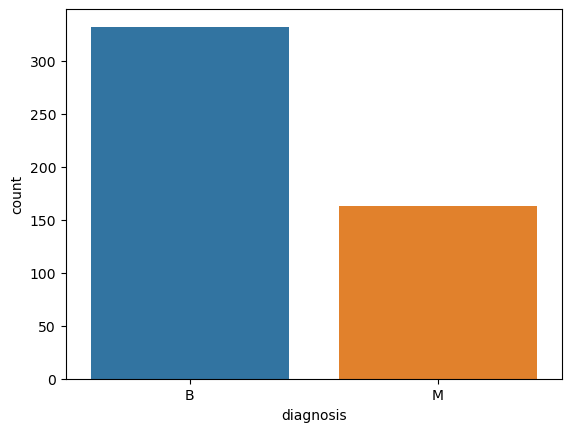

From above plot it can be seen that Benign count is more comapre to Malignant count


In [11]:
# Count the diagnosis values
sns.countplot(x='diagnosis', data=data)
plt.show()

# Insights
print("From above plot it can be seen that Benign count is more comapre to Malignant count")

In [4]:
# Pairplot to visualize correlations between features
sns.pairplot(data, hue='diagnosis')
plt.show()

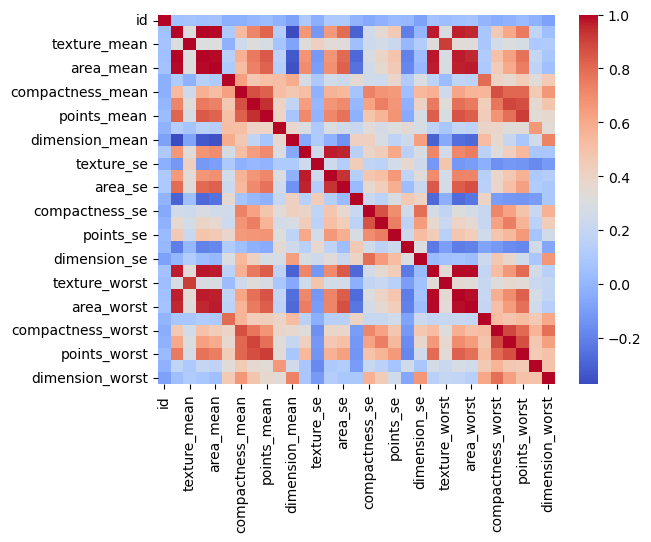

The 'radius_mean', 'perimeter_mean', and 'area_mean' features are highly correlated with each other and with the target variable, indicating that they may be good predictors of breast cancer diagnosis.


In [12]:
# Correlation heatmap
sns.heatmap(data.corr(), cmap='coolwarm')
plt.show()

# Insights
print("The 'radius_mean', 'perimeter_mean', and 'area_mean' features are highly correlated with each other and with the target variable, indicating that they may be good predictors of breast cancer diagnosis.")

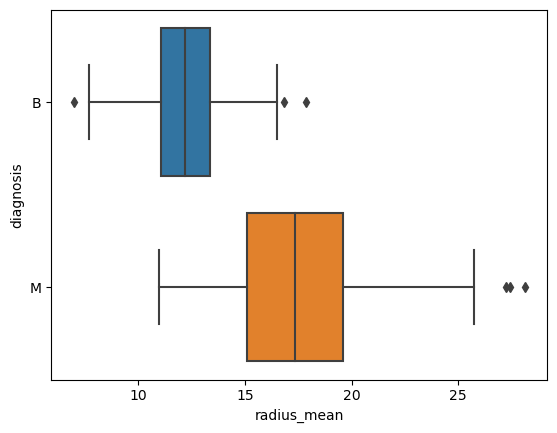

No. of rows and columns after removing outlier:  (495, 32)


In [6]:
# Boxplot to visualize outliers
sns.boxplot(x='radius_mean', y='diagnosis', data=data)
plt.show()

# Remove outliers using z-score method
from scipy import stats
import numpy as np

z = np.abs(stats.zscore(data.drop(['id', 'diagnosis'], axis=1)))
data = data[(z < 3).all(axis=1)]

# show no. of rows after removing outlier
print("No. of rows and columns after removing outlier: ", data.shape)


In [10]:
from scipy.stats import ttest_ind

# Perform a t-test to compare the means of two groups (M and B)
m_data = data[data['diagnosis'] == 'M']
b_data = data[data['diagnosis'] == 'B']
t, p = ttest_ind(m_data['radius_mean'], b_data['radius_mean'])
print(f"t-value: {t:.2f}, p-value: {p:.2f}")

# Insights
print("The t-test shows the means of the 'radius_mean' feature for the M and B groups")

t-value: 24.52, p-value: 0.00
The t-test shows the means of the 'radius_mean' feature for the M and B groups


In [7]:
# import necessary libraries
from sklearn.preprocessing import MinMaxScaler
import warnings

# ignore warnings
warnings.filterwarnings("ignore")

# Normalize the features using Min-Max scaling
scaler = MinMaxScaler()
data[data.drop(['id', 'diagnosis'], axis=1).columns] = scaler.fit_transform(data.drop(['id', 'diagnosis'], axis=1))

# Check for duplicate rows
print(data.duplicated().sum())

# Drop duplicate rows
data.drop_duplicates()


0


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,points_worst,symmetry_worst,dimension_worst
0,87139402,B,0.327767,0.127558,0.323700,0.207844,0.540153,0.241269,0.125614,0.236876,...,0.274926,0.122339,0.251289,0.164082,0.522116,0.146481,0.146307,0.347686,0.395859,0.160258
1,8910251,B,0.222174,0.439791,0.235343,0.131540,0.460786,0.456033,0.201229,0.169142,...,0.194965,0.369044,0.191560,0.108035,0.365253,0.344741,0.225704,0.293447,0.431305,0.263471
2,905520,B,0.249187,0.338886,0.250485,0.148914,0.605845,0.280643,0.095967,0.158771,...,0.221125,0.487327,0.202901,0.129047,0.507524,0.180768,0.125692,0.275120,0.449498,0.300658
3,868871,B,0.263920,0.175155,0.269689,0.156434,0.722483,0.450770,0.146030,0.307042,...,0.196940,0.126732,0.179531,0.112183,0.505700,0.234738,0.102120,0.318808,0.168444,0.161902
4,9012568,B,0.503960,0.166587,0.497276,0.368428,0.229521,0.239020,0.106900,0.170102,...,0.408193,0.125380,0.371778,0.285824,0.285910,0.221245,0.160443,0.302777,0.289210,0.159626
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
563,894855,B,0.360918,0.171823,0.360355,0.234230,0.682263,0.329921,0.119723,0.217670,...,0.301579,0.306185,0.291360,0.186807,0.669859,0.299660,0.210979,0.427619,0.256274,0.385656
564,911320502,B,0.379950,0.405045,0.373834,0.255300,0.162890,0.194048,0.153088,0.183739,...,0.344028,0.401149,0.307169,0.226531,0.428181,0.257437,0.220992,0.386894,0.210163,0.179737
566,873885,M,0.509485,0.604474,0.509002,0.367650,0.376190,0.410583,0.169345,0.208899,...,0.487167,0.541061,0.435700,0.355262,0.445508,0.469189,0.427612,0.453906,0.505019,0.539843
567,911201,B,0.463442,0.203237,0.462284,0.324603,0.635340,0.349440,0.217234,0.415813,...,0.388450,0.165934,0.362155,0.254622,0.487460,0.180133,0.161739,0.395779,0.326537,0.291677


Apply Three ML classifier models and predict accuracy

In [8]:
# importing necessary libraries
import warnings
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score

# ignore warnings
warnings.filterwarnings("ignore")

# Split the data into features (X) and target (y)
X = data.drop(['id', 'diagnosis'], axis=1)
y = data['diagnosis']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a list of classifiers to test
classifiers = [
    DecisionTreeClassifier(),
    RandomForestClassifier(),
    KNeighborsClassifier()
]

# Test each classifier using 10-fold cross-validation
for clf in classifiers:
    scores = cross_val_score(clf, X_train, y_train, cv=10)
    print(f"{clf.__class__.__name__}: {scores.mean():.2f} +/- {scores.std():.2f}")


from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to test for the selected algorithm
params = {
    'n_estimators': [10, 50, 100, 500],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Test the hyperparameters using 10-fold cross-validation
grid = GridSearchCV(RandomForestClassifier(), params, cv=10)
grid.fit(X_train, y_train)

# Print the best hyperparameters and accuracy
print(f"Best hyperparameters: {grid.best_params_}")
print(f"Accuracy: {grid.best_score_:.2f}")


# Train the final model with the best hyperparameters
model = RandomForestClassifier(**grid.best_params_)
model.fit(X_train, y_train)

# Evaluate the final model on the test set
accuracy = model.score(X_test, y_test)
print(f"Test accuracy: {accuracy:.2f}")



DecisionTreeClassifier: 0.93 +/- 0.04
RandomForestClassifier: 0.95 +/- 0.03
KNeighborsClassifier: 0.96 +/- 0.03
Best hyperparameters: {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 50}
Accuracy: 0.96
Test accuracy: 0.95
